In [3]:
import pandas as pd
import numpy as np
import os
import matplotlib
from matplotlib import pyplot as plt
import pylab
from pylab import plot,show,legend,title,xlabel,ylabel
import seaborn as sns
import scipy.stats as stats
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
import statsmodels.api as sm
from sklearn.metrics import classification_report, accuracy_score
from sklearn.metrics import classification_report, accuracy_score

In [4]:
main_df=pd.read_csv("data.csv")

In [5]:
main_df

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,...,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
0,1,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,...,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,1,0.016469
1,1,0.464291,0.538214,0.516730,0.610235,0.610235,0.998946,0.797380,0.809301,0.303556,...,0.795297,0.008323,0.623652,0.610237,0.839969,0.283846,0.264577,0.570175,1,0.020794
2,1,0.426071,0.499019,0.472295,0.601450,0.601364,0.998857,0.796403,0.808388,0.302035,...,0.774670,0.040003,0.623841,0.601449,0.836774,0.290189,0.026555,0.563706,1,0.016474
3,1,0.399844,0.451265,0.457733,0.583541,0.583541,0.998700,0.796967,0.808966,0.303350,...,0.739555,0.003252,0.622929,0.583538,0.834697,0.281721,0.026697,0.564663,1,0.023982
4,1,0.465022,0.538432,0.522298,0.598783,0.598783,0.998973,0.797366,0.809304,0.303475,...,0.795016,0.003878,0.623521,0.598782,0.839973,0.278514,0.024752,0.575617,1,0.035490
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6814,0,0.493687,0.539468,0.543230,0.604455,0.604462,0.998992,0.797409,0.809331,0.303510,...,0.799927,0.000466,0.623620,0.604455,0.840359,0.279606,0.027064,0.566193,1,0.029890
6815,0,0.475162,0.538269,0.524172,0.598308,0.598308,0.998992,0.797414,0.809327,0.303520,...,0.799748,0.001959,0.623931,0.598306,0.840306,0.278132,0.027009,0.566018,1,0.038284
6816,0,0.472725,0.533744,0.520638,0.610444,0.610213,0.998984,0.797401,0.809317,0.303512,...,0.797778,0.002840,0.624156,0.610441,0.840138,0.275789,0.026791,0.565158,1,0.097649
6817,0,0.506264,0.559911,0.554045,0.607850,0.607850,0.999074,0.797500,0.809399,0.303498,...,0.811808,0.002837,0.623957,0.607846,0.841084,0.277547,0.026822,0.565302,1,0.044009


In [6]:
pd.set_option("display.max_columns",None) #used to display complete columns and same for rows also

In [7]:
main_df

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),Operating Expense Rate,Research and development expense rate,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Cash Flow Per Share,Revenue Per Share (Yuan ¥),Operating Profit Per Share (Yuan ¥),Per Share Net profit before tax (Yuan ¥),Realized Sales Gross Profit Growth Rate,Operating Profit Growth Rate,After-tax Net Profit Growth Rate,Regular Net Profit Growth Rate,Continuous Net Profit Growth Rate,Total Asset Growth Rate,Net Value Growth Rate,Total Asset Return Growth Rate Ratio,Cash Reinvestment %,Current Ratio,Quick Ratio,Interest Expense Ratio,Total debt/Total net worth,Debt ratio %,Net worth/Assets,Long-term fund suitability ratio (A),Borrowing dependency,Contingent liabilities/Net worth,Operating profit/Paid-in capital,Net profit before tax/Paid-in capital,Inventory and accounts receivable/Net value,Total Asset Turnover,Accounts Receivable Turnover,Average Collection Days,Inventory Turnover Rate (times),Fixed Assets Turnover Frequency,Net Worth Turnover Rate (times),Revenue per person,Operating profit per person,Allocation rate per person,Working Capital to Total Assets,Quick Assets/Total Assets,Current Assets/Total Assets,Cash/Total Assets,Quick Assets/Current Liability,Cash/Current Liability,Current Liability to Assets,Operating Funds to Liability,Inventory/Working Capital,Inventory/Current Liability,Current Liabilities/Liability,Working Capital/Equity,Current Liabilities/Equity,Long-term Liability to Current Assets,Retained Earnings to Total Assets,Total income/Total expense,Total expense/Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Working capitcal Turnover Rate,Cash Turnover Rate,Cash Flow to Sales,Fixed Assets to Assets,Current Liability to Liability,Current Liability to Equity,Equity to Long-term Liability,Cash Flow to Total Assets,Cash Flow to Liability,CFO to Assets,Cash Flow to Equity,Current Liability to Current Assets,Liability-Assets Flag,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
0,1,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,0.780985,1.256969e-04,0.000000e+00,0.458143,7.250725e-04,0.000000,0.147950,0.147950,0.147950,0.169141,0.311664,0.017560,0.095921,0.138736,0.022102,0.848195,0.688979,0.688979,0.217535,4.980000e+09,0.000327,0.263100,0.363725,0.002259,0.001208,0.629951,0.021266,0.207576,0.792424,0.005024,0.390284,0.006479,0.095885,0.137757,0.398036,0.086957,0.001814,0.003487,1.820926e-04,1.165007e-04,0.032903,0.034164,0.392913,0.037135,0.672775,0.166673,0.190643,0.004094,0.001997,1.473360e-04,0.147308,0.334015,0.276920,0.001036,0.676269,0.721275,0.339077,2.559237e-02,0.903225,0.002022,0.064856,7.010000e+08,6.550000e+09,0.593831,4.580000e+08,0.671568,0.424206,0.676269,0.339077,0.126549,0.637555,0.458609,0.520382,0.312905,0.118250,0,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,1,0.016469
1,1,0.464291,0.538214,0.516730,0.610235,0.610235,0.998946,0.797380,0.809301,0.303556,0.781506,2.897851e-04,0.000000e+00,0.461867,6.470647e-04,0.000000,0.182251,0.182251,0.182251,0.208944,0.318137,0.021144,0.093722,0.169918,0.022080,0.848088,0.689693,0.689702,0.217620,6.110000e+09,0.000443,0.264516,0.376709,0.006016,0.004039,0.635172,0.012502,0.171176,0.828824,0.005059,0.376760,0.005835,0.093743,0.168962,0.397725,0.064468,0.001286,0.004917,9

In [8]:
main_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6819 entries, 0 to 6818
Data columns (total 96 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   Bankrupt?                                                 6819 non-null   int64  
 1    ROA(C) before interest and depreciation before interest  6819 non-null   float64
 2    ROA(A) before interest and % after tax                   6819 non-null   float64
 3    ROA(B) before interest and depreciation after tax        6819 non-null   float64
 4    Operating Gross Margin                                   6819 non-null   float64
 5    Realized Sales Gross Margin                              6819 non-null   float64
 6    Operating Profit Rate                                    6819 non-null   float64
 7    Pre-tax net Interest Rate                                6819 non-null   float64
 8    After-tax net Int

In [9]:
main_df.isnull().sum()

Bankrupt?                                                   0
 ROA(C) before interest and depreciation before interest    0
 ROA(A) before interest and % after tax                     0
 ROA(B) before interest and depreciation after tax          0
 Operating Gross Margin                                     0
                                                           ..
 Liability to Equity                                        0
 Degree of Financial Leverage (DFL)                         0
 Interest Coverage Ratio (Interest expense to EBIT)         0
 Net Income Flag                                            0
 Equity to Liability                                        0
Length: 96, dtype: int64

In [10]:
main_df.duplicated().sum()

0

In [11]:
main_df.describe()

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),Operating Expense Rate,Research and development expense rate,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Cash Flow Per Share,Revenue Per Share (Yuan ¥),Operating Profit Per Share (Yuan ¥),Per Share Net profit before tax (Yuan ¥),Realized Sales Gross Profit Growth Rate,Operating Profit Growth Rate,After-tax Net Profit Growth Rate,Regular Net Profit Growth Rate,Continuous Net Profit Growth Rate,Total Asset Growth Rate,Net Value Growth Rate,Total Asset Return Growth Rate Ratio,Cash Reinvestment %,Current Ratio,Quick Ratio,Interest Expense Ratio,Total debt/Total net worth,Debt ratio %,Net worth/Assets,Long-term fund suitability ratio (A),Borrowing dependency,Contingent liabilities/Net worth,Operating profit/Paid-in capital,Net profit before tax/Paid-in capital,Inventory and accounts receivable/Net value,Total Asset Turnover,Accounts Receivable Turnover,Average Collection Days,Inventory Turnover Rate (times),Fixed Assets Turnover Frequency,Net Worth Turnover Rate (times),Revenue per person,Operating profit per person,Allocation rate per person,Working Capital to Total Assets,Quick Assets/Total Assets,Current Assets/Total Assets,Cash/Total Assets,Quick Assets/Current Liability,Cash/Current Liability,Current Liability to Assets,Operating Funds to Liability,Inventory/Working Capital,Inventory/Current Liability,Current Liabilities/Liability,Working Capital/Equity,Current Liabilities/Equity,Long-term Liability to Current Assets,Retained Earnings to Total Assets,Total income/Total expense,Total expense/Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Working capitcal Turnover Rate,Cash Turnover Rate,Cash Flow to Sales,Fixed Assets to Assets,Current Liability to Liability,Current Liability to Equity,Equity to Long-term Liability,Cash Flow to Total Assets,Cash Flow to Liability,CFO to Assets,Cash Flow to Equity,Current Liability to Current Assets,Liability-Assets Flag,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
count,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6.819000e+03,6.819000e+03,6819.000000,6.819000e+03,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6.819000e+03,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6.819000e+03,6.819000e+03,6819.000000,6819.000000,6.819000e+03,6.819000e+03,6819.000000,6.819000e+03,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6.819000e+03,6.819000e+03,6.819000e+03,6.819000e+03,6819.000000,6.819000e+03,6819.000000,6.819000e+03,6819.000000,6819.000000,6819.000000,6819.000000,6.819000e+03,6.819000e+03,6819.000000,6819.000000,6819.000000,6.819000e+03,6819.000000,6819.000000,6819.000000,6.819000e+03,6819.000000,6819.000000,6819.000000,6.819000e+03,6.819000e+03,6819.000000,6.819000e+03,6819.000000,6.819000e+03,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6.819000e+03,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.0,6819.000000
mean,0.032263,0.505180,0.558625,0.553589,0.607948,0.607929,0.998755,0.797190,0.809084,0.303623,0.781381,1.995347e+09,1.950427e+09,0.467431,1.644801e+07,0.11

# WE HAVE TO CHECK Correlation

In [12]:
main_df.corr()

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),Operating Expense Rate,Research and development expense rate,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Cash Flow Per Share,Revenue Per Share (Yuan ¥),Operating Profit Per Share (Yuan ¥),Per Share Net profit before tax (Yuan ¥),Realized Sales Gross Profit Growth Rate,Operating Profit Growth Rate,After-tax Net Profit Growth Rate,Regular Net Profit Growth Rate,Continuous Net Profit Growth Rate,Total Asset Growth Rate,Net Value Growth Rate,Total Asset Return Growth Rate Ratio,Cash Reinvestment %,Current Ratio,Quick Ratio,Interest Expense Ratio,Total debt/Total net worth,Debt ratio %,Net worth/Assets,Long-term fund suitability ratio (A),Borrowing dependency,Contingent liabilities/Net worth,Operating profit/Paid-in capital,Net profit before tax/Paid-in capital,Inventory and accounts receivable/Net value,Total Asset Turnover,Accounts Receivable Turnover,Average Collection Days,Inventory Turnover Rate (times),Fixed Assets Turnover Frequency,Net Worth Turnover Rate (times),Revenue per person,Operating profit per person,Allocation rate per person,Working Capital to Total Assets,Quick Assets/Total Assets,Current Assets/Total Assets,Cash/Total Assets,Quick Assets/Current Liability,Cash/Current Liability,Current Liability to Assets,Operating Funds to Liability,Inventory/Working Capital,Inventory/Current Liability,Current Liabilities/Liability,Working Capital/Equity,Current Liabilities/Equity,Long-term Liability to Current Assets,Retained Earnings to Total Assets,Total income/Total expense,Total expense/Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Working capitcal Turnover Rate,Cash Turnover Rate,Cash Flow to Sales,Fixed Assets to Assets,Current Liability to Liability,Current Liability to Equity,Equity to Long-term Liability,Cash Flow to Total Assets,Cash Flow to Liability,CFO to Assets,Cash Flow to Equity,Current Liability to Current Assets,Liability-Assets Flag,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
Bankrupt?,1.000000,-0.260807,-0.282941,-0.273051,-0.100043,-0.099445,-0.000230,-0.008517,-0.008857,-0.016593,-0.008395,-0.006083,-0.024232,-0.072356,-0.023063,-0.109706,-0.165399,-0.165465,-0.164784,-0.219560,-0.077516,-0.004692,-0.142051,-0.201395,-0.000458,-0.015168,-0.037783,-0.036820,-0.009401,-0.044431,0.065329,-0.016858,-0.051345,-0.002211,0.025058,-0.002681,0.012314,0.250161,-0.250161,0.016920,0.176543,0.070455,-0.141111,-0.207857,0.075278,-0.067915,-0.004754,-0.006556,-0.001376,0.072818,0.021089,0.039718,-0.092842,0.002829,-0.193083,-0.086382,-0.044823,-0.100130,-0.003823,0.077921,0.194494,-0.077082,-0.001906,0.000822,-0.020809,-0.147221,0.153828,0.000778,-0.217779,-0.007137,0.139049,0.011929,0.025814,-0.002894,-0.018035,0.000479,0.066328,-0.020809,0.153828,0.139014,-0.070456,-0.043125,-0.115383,-0.058563,0.171306,0.139212,-0.315457,0.035104,-0.005547,-0.100044,-0.180987,0.166812,0.010508,-0.005509,NaN,-0.083048
ROA(C) before interest and depreciation before interest,-0.260807,1.000000,0.940124,0.986849,0.334719,0.332755,0.035725,0.053419,0.049222,0.020501,0.051328,0.066869,0.106461,0.323482,0.048882,0.250761,0.505580,0.505407,0.505281,0.775006,0.379839,-0.015932,0.687201,0.750564,0.000591,0.036511,0.115083,0.115040,0.025234,0.019635,-0.021930,0.079906,0.296158,0.013196,-0.026336,0.003988,-0.022208,-0.26

In [13]:
# Insights

we check Liability-Assets
o--> which not have Liability-Assets
1--> Which is have Liability-Assets

In [14]:
main_df[" Liability-Assets Flag"].value_counts()

 Liability-Assets Flag
0    6811
1       8
Name: count, dtype: int64

In [15]:
main_df.loc[main_df["Bankrupt?"]>0.10].index.to_list() #we saw the rows those corr is greater than 0.10

[0,
 1,
 2,
 3,
 4,
 5,
 29,
 30,
 54,
 55,
 56,
 57,
 81,
 105,
 106,
 132,
 158,
 184,
 185,
 186,
 230,
 231,
 232,
 233,
 234,
 235,
 236,
 284,
 379,
 427,
 476,
 525,
 526,
 527,
 576,
 645,
 715,
 792,
 869,
 870,
 947,
 948,
 1025,
 1026,
 1104,
 1118,
 1132,
 1147,
 1166,
 1171,
 1176,
 1177,
 1178,
 1179,
 1210,
 1211,
 1212,
 1213,
 1214,
 1215,
 1247,
 1279,
 1311,
 1344,
 1358,
 1359,
 1441,
 1442,
 1443,
 1444,
 1445,
 1446,
 1447,
 1534,
 1535,
 1638,
 1639,
 1640,
 1750,
 1751,
 1752,
 1753,
 1754,
 1755,
 1756,
 1757,
 1758,
 1759,
 1860,
 1861,
 1862,
 1863,
 1864,
 1865,
 1866,
 1867,
 1868,
 1869,
 1870,
 1871,
 1872,
 1948,
 1949,
 1950,
 1951,
 1952,
 1953,
 1954,
 2000,
 2001,
 2002,
 2003,
 2004,
 2022,
 2023,
 2024,
 2025,
 2026,
 2027,
 2041,
 2042,
 2043,
 2044,
 2045,
 2046,
 2093,
 2094,
 2095,
 2096,
 2097,
 2098,
 2099,
 2100,
 2147,
 2148,
 2149,
 2197,
 2198,
 2245,
 2246,
 2293,
 2294,
 2295,
 2343,
 2344,
 2392,
 2440,
 2441,
 2470,
 2496,
 2523,
 253

In [16]:
(main_df.corr()[["Bankrupt?"]]>0.10).index # we have taken out the columns here

Index(['Bankrupt?', ' ROA(C) before interest and depreciation before interest',
       ' ROA(A) before interest and % after tax',
       ' ROA(B) before interest and depreciation after tax',
       ' Operating Gross Margin', ' Realized Sales Gross Margin',
       ' Operating Profit Rate', ' Pre-tax net Interest Rate',
       ' After-tax net Interest Rate',
       ' Non-industry income and expenditure/revenue',
       ' Continuous interest rate (after tax)', ' Operating Expense Rate',
       ' Research and development expense rate', ' Cash flow rate',
       ' Interest-bearing debt interest rate', ' Tax rate (A)',
       ' Net Value Per Share (B)', ' Net Value Per Share (A)',
       ' Net Value Per Share (C)', ' Persistent EPS in the Last Four Seasons',
       ' Cash Flow Per Share', ' Revenue Per Share (Yuan ¥)',
       ' Operating Profit Per Share (Yuan ¥)',
       ' Per Share Net profit before tax (Yuan ¥)',
       ' Realized Sales Gross Profit Growth Rate',
       ' Operating Profit

In [17]:
col=(main_df.corr()[["Bankrupt?"]]<-20)
print(col.to_markdown()) # now we have done markdown down here 

|                                                         |   Bankrupt? |
|:--------------------------------------------------------|------------:|
| Bankrupt?                                               |           0 |
| ROA(C) before interest and depreciation before interest |           0 |
| ROA(A) before interest and % after tax                  |           0 |
| ROA(B) before interest and depreciation after tax       |           0 |
| Operating Gross Margin                                  |           0 |
| Realized Sales Gross Margin                             |           0 |
| Operating Profit Rate                                   |           0 |
| Pre-tax net Interest Rate                               |           0 |
| After-tax net Interest Rate                             |           0 |
| Non-industry income and expenditure/revenue             |           0 |
| Continuous interest rate (after tax)                    |           0 |
| Operating Expense Rate              

In [18]:
pip install tabulate

Note: you may need to restart the kernel to use updated packages.


In [19]:
(main_df.corr()[["Bankrupt?"]]>0.10).sum()

Bankrupt?    11
dtype: int64

In [20]:
Correlation=main_df.corr()
Correlation

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),Operating Expense Rate,Research and development expense rate,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Cash Flow Per Share,Revenue Per Share (Yuan ¥),Operating Profit Per Share (Yuan ¥),Per Share Net profit before tax (Yuan ¥),Realized Sales Gross Profit Growth Rate,Operating Profit Growth Rate,After-tax Net Profit Growth Rate,Regular Net Profit Growth Rate,Continuous Net Profit Growth Rate,Total Asset Growth Rate,Net Value Growth Rate,Total Asset Return Growth Rate Ratio,Cash Reinvestment %,Current Ratio,Quick Ratio,Interest Expense Ratio,Total debt/Total net worth,Debt ratio %,Net worth/Assets,Long-term fund suitability ratio (A),Borrowing dependency,Contingent liabilities/Net worth,Operating profit/Paid-in capital,Net profit before tax/Paid-in capital,Inventory and accounts receivable/Net value,Total Asset Turnover,Accounts Receivable Turnover,Average Collection Days,Inventory Turnover Rate (times),Fixed Assets Turnover Frequency,Net Worth Turnover Rate (times),Revenue per person,Operating profit per person,Allocation rate per person,Working Capital to Total Assets,Quick Assets/Total Assets,Current Assets/Total Assets,Cash/Total Assets,Quick Assets/Current Liability,Cash/Current Liability,Current Liability to Assets,Operating Funds to Liability,Inventory/Working Capital,Inventory/Current Liability,Current Liabilities/Liability,Working Capital/Equity,Current Liabilities/Equity,Long-term Liability to Current Assets,Retained Earnings to Total Assets,Total income/Total expense,Total expense/Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Working capitcal Turnover Rate,Cash Turnover Rate,Cash Flow to Sales,Fixed Assets to Assets,Current Liability to Liability,Current Liability to Equity,Equity to Long-term Liability,Cash Flow to Total Assets,Cash Flow to Liability,CFO to Assets,Cash Flow to Equity,Current Liability to Current Assets,Liability-Assets Flag,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
Bankrupt?,1.000000,-0.260807,-0.282941,-0.273051,-0.100043,-0.099445,-0.000230,-0.008517,-0.008857,-0.016593,-0.008395,-0.006083,-0.024232,-0.072356,-0.023063,-0.109706,-0.165399,-0.165465,-0.164784,-0.219560,-0.077516,-0.004692,-0.142051,-0.201395,-0.000458,-0.015168,-0.037783,-0.036820,-0.009401,-0.044431,0.065329,-0.016858,-0.051345,-0.002211,0.025058,-0.002681,0.012314,0.250161,-0.250161,0.016920,0.176543,0.070455,-0.141111,-0.207857,0.075278,-0.067915,-0.004754,-0.006556,-0.001376,0.072818,0.021089,0.039718,-0.092842,0.002829,-0.193083,-0.086382,-0.044823,-0.100130,-0.003823,0.077921,0.194494,-0.077082,-0.001906,0.000822,-0.020809,-0.147221,0.153828,0.000778,-0.217779,-0.007137,0.139049,0.011929,0.025814,-0.002894,-0.018035,0.000479,0.066328,-0.020809,0.153828,0.139014,-0.070456,-0.043125,-0.115383,-0.058563,0.171306,0.139212,-0.315457,0.035104,-0.005547,-0.100044,-0.180987,0.166812,0.010508,-0.005509,NaN,-0.083048
ROA(C) before interest and depreciation before interest,-0.260807,1.000000,0.940124,0.986849,0.334719,0.332755,0.035725,0.053419,0.049222,0.020501,0.051328,0.066869,0.106461,0.323482,0.048882,0.250761,0.505580,0.505407,0.505281,0.775006,0.379839,-0.015932,0.687201,0.750564,0.000591,0.036511,0.115083,0.115040,0.025234,0.019635,-0.021930,0.079906,0.296158,0.013196,-0.026336,0.003988,-0.022208,-0.26

In [21]:
Corrdf = (Correlation['Bankrupt?']>0.15) | (Correlation['Bankrupt?']<-0.15)
Corrdf.sum()

22

In [22]:
Corr_colms = (Corrdf[Corrdf].index.to_list())
Corr_colms

['Bankrupt?',
 ' ROA(C) before interest and depreciation before interest',
 ' ROA(A) before interest and % after tax',
 ' ROA(B) before interest and depreciation after tax',
 ' Net Value Per Share (B)',
 ' Net Value Per Share (A)',
 ' Net Value Per Share (C)',
 ' Persistent EPS in the Last Four Seasons',
 ' Per Share Net profit before tax (Yuan ¥)',
 ' Debt ratio %',
 ' Net worth/Assets',
 ' Borrowing dependency',
 ' Net profit before tax/Paid-in capital',
 ' Working Capital to Total Assets',
 ' Current Liability to Assets',
 ' Current Liabilities/Equity',
 ' Retained Earnings to Total Assets',
 ' Current Liability to Equity',
 ' Current Liability to Current Assets',
 ' Net Income to Total Assets',
 " Net Income to Stockholder's Equity",
 ' Liability to Equity']

In [23]:
new_df=main_df[Corr_colms]

In [24]:
new_df.shape

(6819, 22)

In [25]:
new_df.corr()

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Per Share Net profit before tax (Yuan ¥),Debt ratio %,Net worth/Assets,Borrowing dependency,Net profit before tax/Paid-in capital,Working Capital to Total Assets,Current Liability to Assets,Current Liabilities/Equity,Retained Earnings to Total Assets,Current Liability to Equity,Current Liability to Current Assets,Net Income to Total Assets,Net Income to Stockholder's Equity,Liability to Equity
Bankrupt?,1.000000,-0.260807,-0.282941,-0.273051,-0.165399,-0.165465,-0.164784,-0.219560,-0.201395,0.250161,-0.250161,0.176543,-0.207857,-0.193083,0.194494,0.153828,-0.217779,0.153828,0.171306,-0.315457,-0.180987,0.166812
ROA(C) before interest and depreciation before interest,-0.260807,1.000000,0.940124,0.986849,0.505580,0.505407,0.505281,0.775006,0.750564,-0.261427,0.261427,-0.161671,0.753339,0.259680,-0.210256,-0.142734,0.650217,-0.142734,-0.160725,0.887670,0.274287,-0.143629
ROA(A) before interest and % after tax,-0.282941,0.940124,1.000000,0.955741,0.531799,0.531790,0.531821,0.764828,0.752578,-0.259972,0.259972,-0.161868,0.758234,0.303532,-0.190501,-0.133816,0.718013,-0.133816,-0.195673,0.961552,0.291744,-0.141039
ROA(B) before interest and depreciation after tax,-0.273051,0.986849,0.955741,1.000000,0.502052,0.502000,0.501907,0.764597,0.722940,-0.264734,0.264734,-0.158618,0.726003,0.260151,-0.217186,-0.142879,0.673738,-0.142879,-0.162572,0.912040,0.280617,-0.142838
Net Value Per Share (B),-0.165399,0.505580,0.531799,0.502052,1.000000,0.999342,0.999179,0.755568,0.726321,-0.249146,0.249146,-0.123991,0.706646,0.198620,-0.198546,-0.102098,0.491365,-0.102098,-0.164367,0.493776,0.148693,-0.110850
Net Value Per Share (A),-0.165465,0.505407,0.531790,0.502000,0.999342,1.000000,0.999837,0.755409,0.725956,-0.249925,0.249925,-0.125321,0.705800,0.199598,-0.199086,-0.102539,0.492760,-0.102539,-0.165083,0.493803,0.148872,-0.111797
Net Value Per Share (C),-0.164784,0.505281,0.531821,0.501907,0.999179,0.999837,1.000000,0.755217,0.725825,-0.249463,0.249463,-0.125188,0.705621,0.199475,-0.198721,-0.102431,0.492734,-0.102431,-0.165011,0.493822,0.148906,-0.111682
Persistent EPS in the Last Four Seasons,-0.219560,0.775006,0.764828,0.764597,0.755568,0.755409,0.755217,1.000000,0.955591,-0.177429,0.177429,-0.144138,0.959461,0.253188,-0.097689,-0.094966,0.492078,-0.094966,-0.154690,0.691152,0.222961,-0.114114
Per Share Net profit before tax (Yuan ¥),-0.201395,0.750564,0.752578,0.722940,0.726321,0.725956,0.725825,0.955591,1.000000,-0.158897,0.158897,-0.142138,0.962723,0.238435,-0.079795,-0.089174,0.473736,-0.089174,-0.148721,0.671748,0.218389,-0.107727
Debt ratio %,0.250161,-0.261427,-0.259972,-0.264734,-0.249146,-0.249925,-0.249463,-0.177429,-0.158897,1.000000,-1.000000,0.329109,-0.164110,-0.528797,0.842583,0.343692,-0.235423,0.343692,0.428180,-0.281422,-0.123986,0.349250


In [26]:
new_df.corr()['Bankrupt?']

Bankrupt?                                                   1.000000
 ROA(C) before interest and depreciation before interest   -0.260807
 ROA(A) before interest and % after tax                    -0.282941
 ROA(B) before interest and depreciation after tax         -0.273051
 Net Value Per Share (B)                                   -0.165399
 Net Value Per Share (A)                                   -0.165465
 Net Value Per Share (C)                                   -0.164784
 Persistent EPS in the Last Four Seasons                   -0.219560
 Per Share Net profit before tax (Yuan ¥)                  -0.201395
 Debt ratio %                                               0.250161
 Net worth/Assets                                          -0.250161
 Borrowing dependency                                       0.176543
 Net profit before tax/Paid-in capital                     -0.207857
 Working Capital to Total Assets                           -0.193083
 Current Liability to Assets      

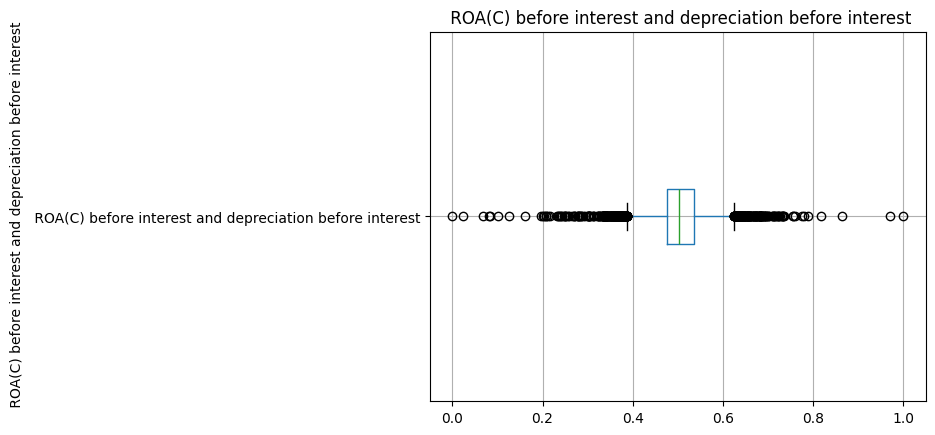

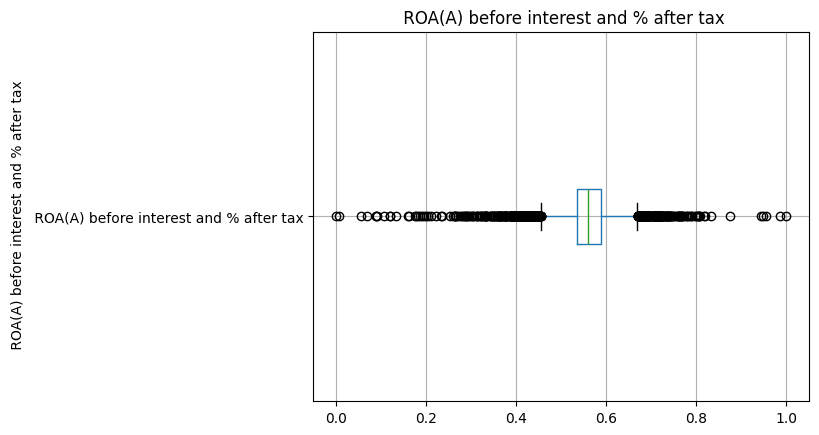

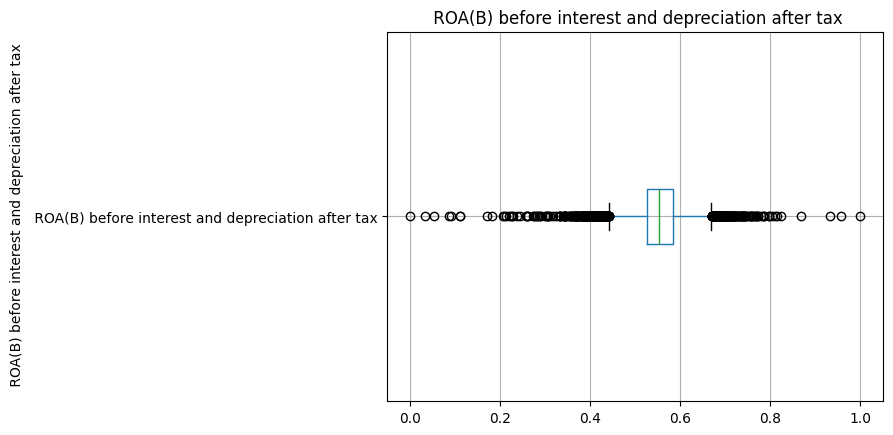

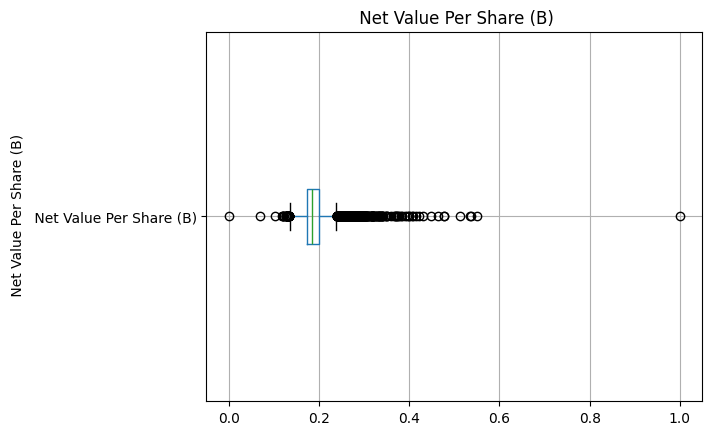

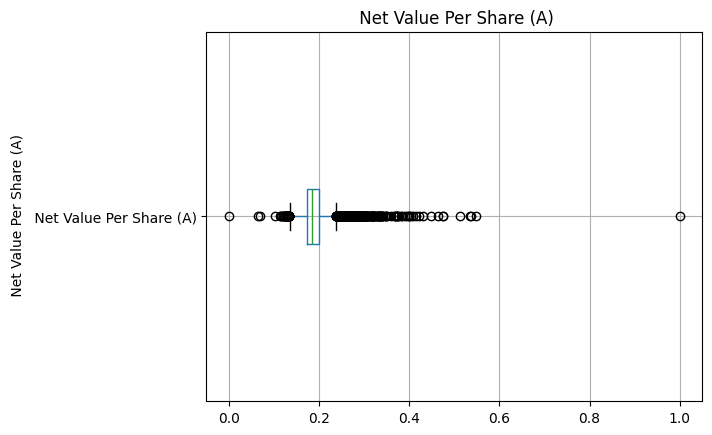

...

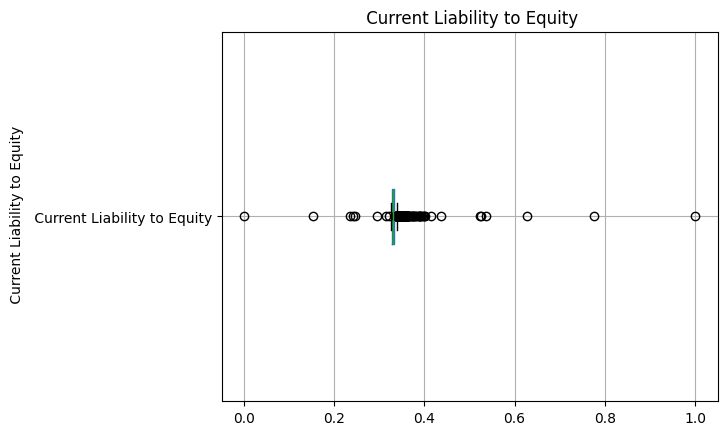

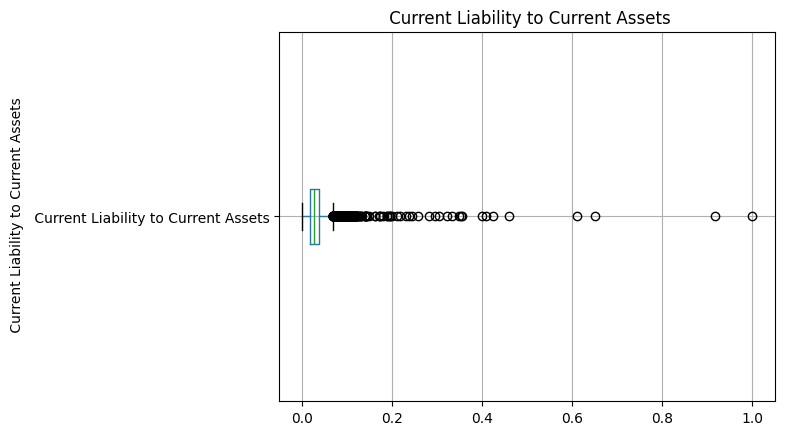

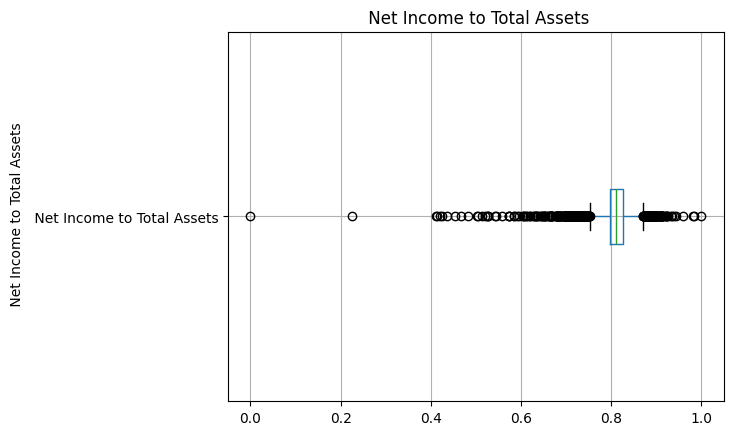

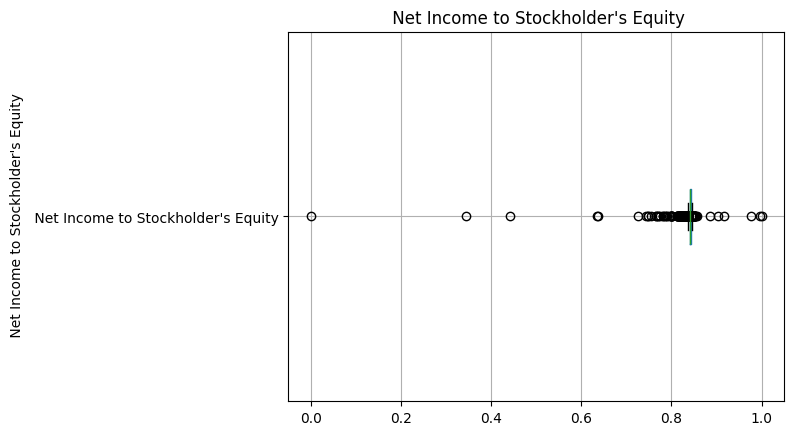

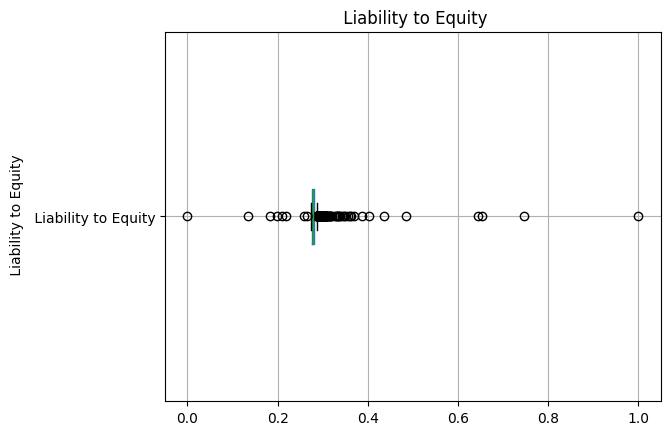

In [27]:
for column in new_df:
    if column != 'Bankrupt?':
        new_df.boxplot(column, vert=False)
        plt.ylabel(column)
        plt.title(column)
        plt.show()

In [28]:
def impute(x):
        q1=new_df[x].quantile(0.25)
        q3=new_df[x].quantile(0.75)
        iqr=q3-q1
        lb=q1-1.5*iqr
        ub=q3+1.5*iqr
        idx=np.where(new_df[x]>ub)
        new_df[x].iloc[idx]=ub
        idx=np.where(new_df[x]<lb)
        new_df[x].iloc[idx]=lb

In [29]:
for column in new_df:
    if column!='Bankrupt?':
        impute(column)

C:\Users\gajja\AppData\Local\Temp\ipykernel_11592\4063240749.py:8: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  new_df[x].iloc[idx]=ub
C:\Users\gajja\AppData\Local\Temp\ipykernel_11592\4063240749.py:8: SettingWithCopyWarning: 
A value is tr

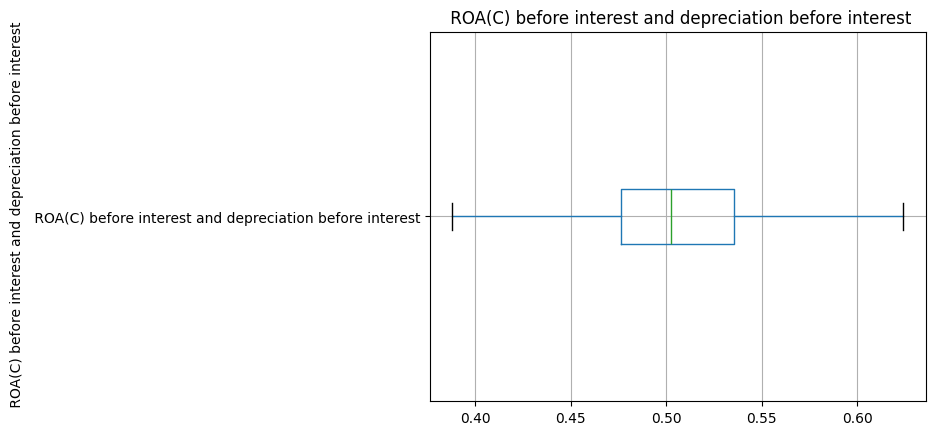

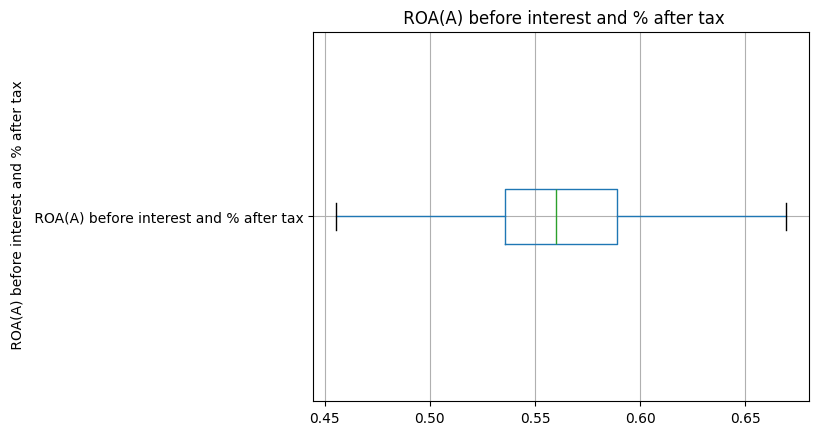

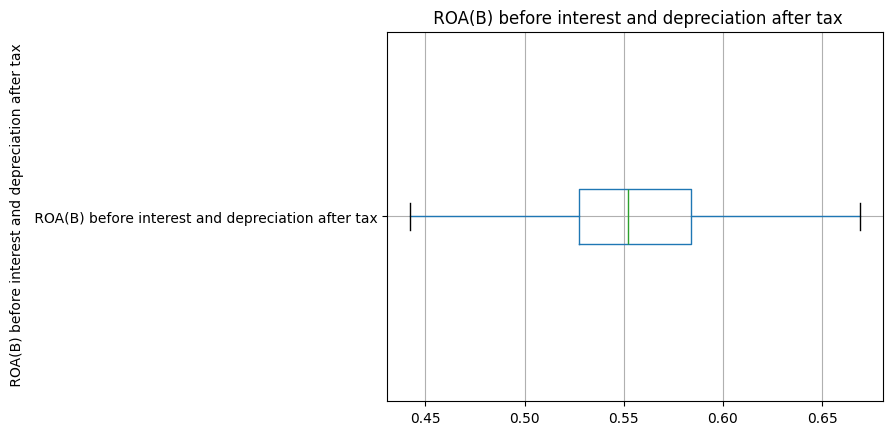

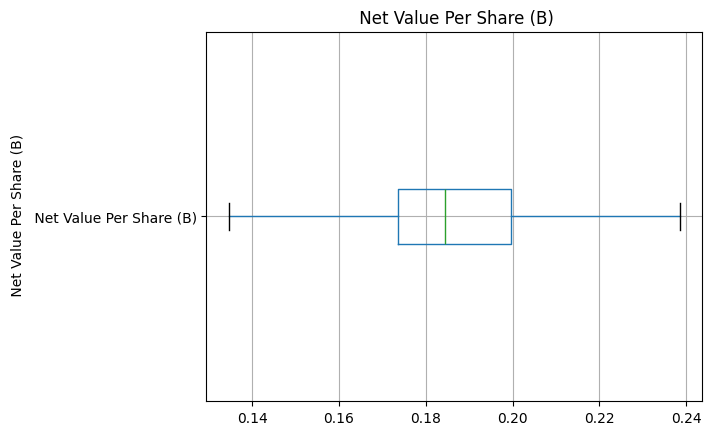

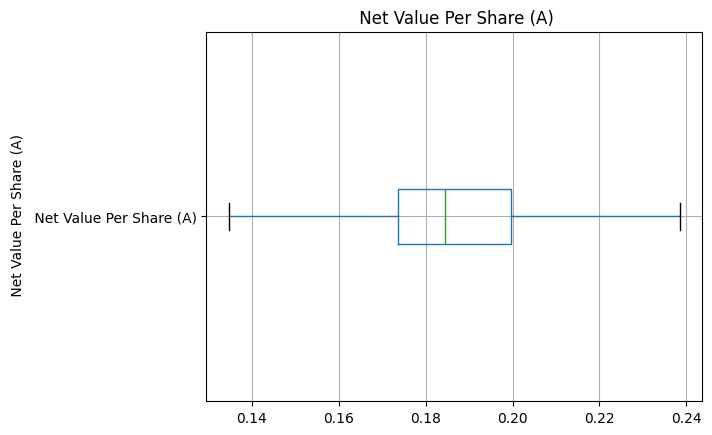

...

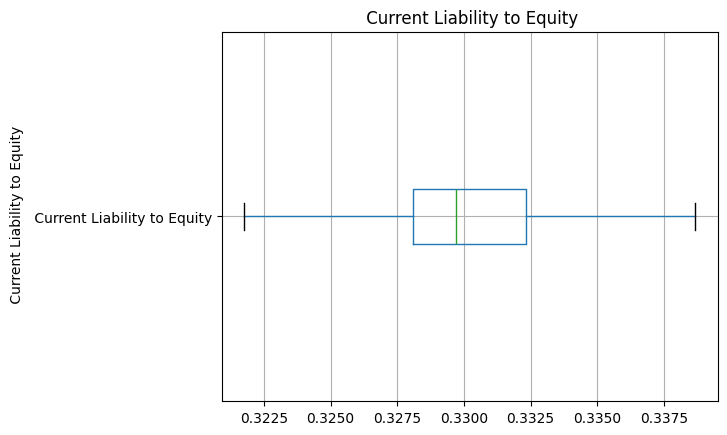

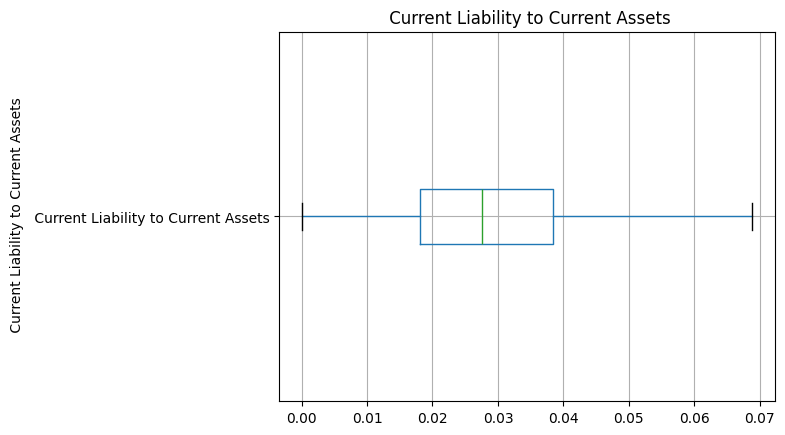

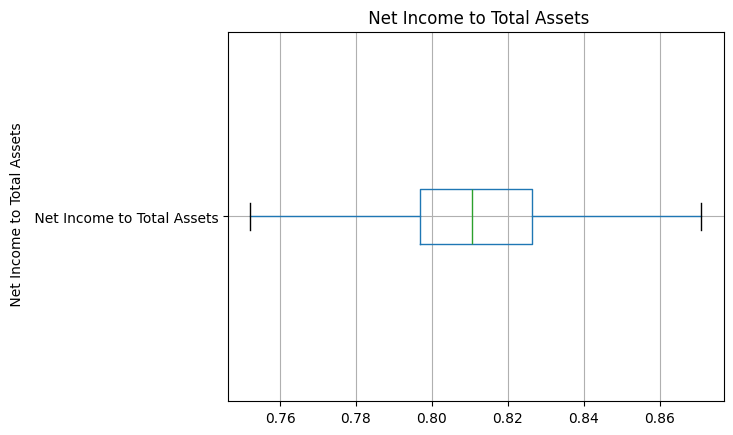

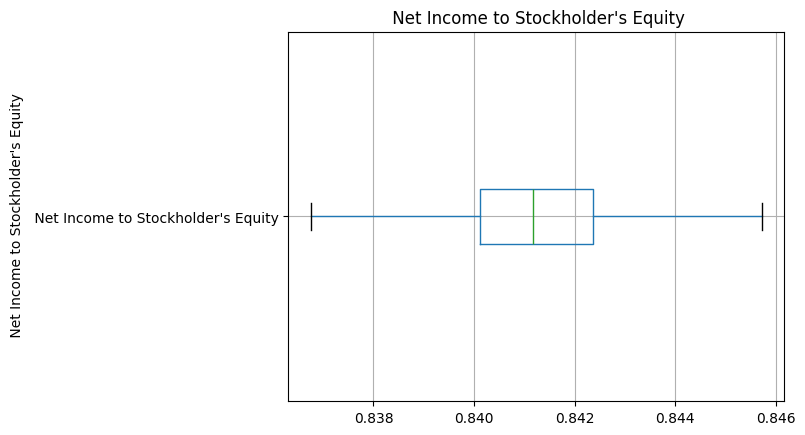

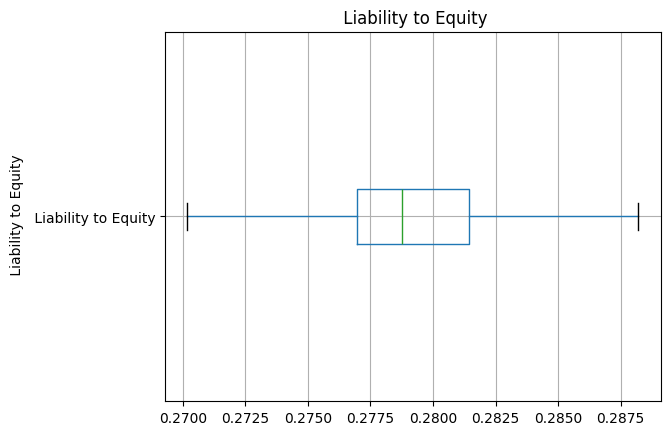

In [30]:
for column in new_df:
    if column != 'Bankrupt?':
        new_df.boxplot(column, vert=False)
        plt.ylabel(column)
        plt.title(column)
        plt.show()

In [31]:
new_df.corr()

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Per Share Net profit before tax (Yuan ¥),Debt ratio %,Net worth/Assets,Borrowing dependency,Net profit before tax/Paid-in capital,Working Capital to Total Assets,Current Liability to Assets,Current Liabilities/Equity,Retained Earnings to Total Assets,Current Liability to Equity,Current Liability to Current Assets,Net Income to Total Assets,Net Income to Stockholder's Equity,Liability to Equity
Bankrupt?,1.000000,-0.239543,-0.239500,-0.241993,-0.214143,-0.213725,-0.212643,-0.256159,-0.246001,0.246535,-0.246535,0.278367,-0.247467,-0.193536,0.193564,0.216619,-0.255218,0.216619,0.229231,-0.255797,-0.251917,0.246176
ROA(C) before interest and depreciation before interest,-0.239543,1.000000,0.941564,0.988614,0.588946,0.588611,0.588297,0.893970,0.881307,-0.257131,0.257131,-0.311573,0.879985,0.269399,-0.199588,-0.231259,0.804321,-0.231259,-0.269303,0.930357,0.890314,-0.258969
ROA(A) before interest and % after tax,-0.239500,0.941564,1.000000,0.952666,0.632623,0.632445,0.632342,0.921063,0.922413,-0.254966,0.254966,-0.331452,0.921472,0.330507,-0.167985,-0.208058,0.855882,-0.208058,-0.312334,0.990799,0.952613,-0.254115
ROA(B) before interest and depreciation after tax,-0.241993,0.988614,0.952666,1.000000,0.590792,0.590570,0.590273,0.898765,0.870886,-0.262526,0.262526,-0.310342,0.869560,0.275874,-0.206864,-0.237615,0.807971,-0.237615,-0.275232,0.942100,0.900832,-0.263275
Net Value Per Share (B),-0.214143,0.588946,0.632623,0.590792,1.000000,0.999685,0.999377,0.744692,0.744174,-0.266698,0.266698,-0.311011,0.746513,0.218768,-0.212164,-0.239342,0.766730,-0.239342,-0.256526,0.637903,0.619449,-0.266413
Net Value Per Share (A),-0.213725,0.588611,0.632445,0.590570,0.999685,1.000000,0.999692,0.744487,0.743806,-0.267246,0.267246,-0.311734,0.745822,0.219628,-0.212750,-0.240170,0.766915,-0.240170,-0.257635,0.637742,0.619532,-0.267166
Net Value Per Share (C),-0.212643,0.588297,0.632342,0.590273,0.999377,0.999692,1.000000,0.744106,0.743572,-0.266587,0.266587,-0.311001,0.745537,0.219340,-0.212300,-0.239524,0.766583,-0.239524,-0.257394,0.637584,0.619390,-0.266440
Persistent EPS in the Last Four Seasons,-0.256159,0.893970,0.921063,0.898765,0.744692,0.744487,0.744106,1.000000,0.976448,-0.200945,0.200945,-0.310776,0.979568,0.303566,-0.113010,-0.153787,0.840303,-0.153787,-0.281369,0.915104,0.919061,-0.202148
Per Share Net profit before tax (Yuan ¥),-0.246001,0.881307,0.922413,0.870886,0.744174,0.743806,0.743572,0.976448,1.000000,-0.191772,0.191772,-0.311432,0.994087,0.301212,-0.102651,-0.143616,0.838351,-0.143616,-0.278623,0.912363,0.917364,-0.193825
Debt ratio %,0.246535,-0.257131,-0.254966,-0.262526,-0.266698,-0.267246,-0.266587,-0.200945,-0.191772,1.000000,-1.000000,0.811985,-0.194393,-0.510494,0.837365,0.876401,-0.317577,0.876401,0.657577,-0.297998,-0.172067,0.948082


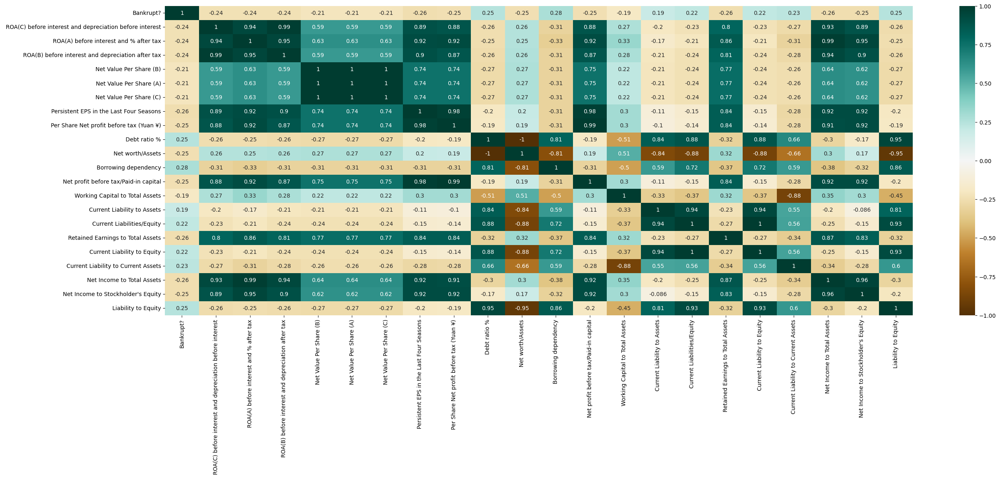

In [32]:
plt.figure(figsize=(30,10))
show(sns.heatmap(new_df.corr(),cmap="BrBG",annot=True))

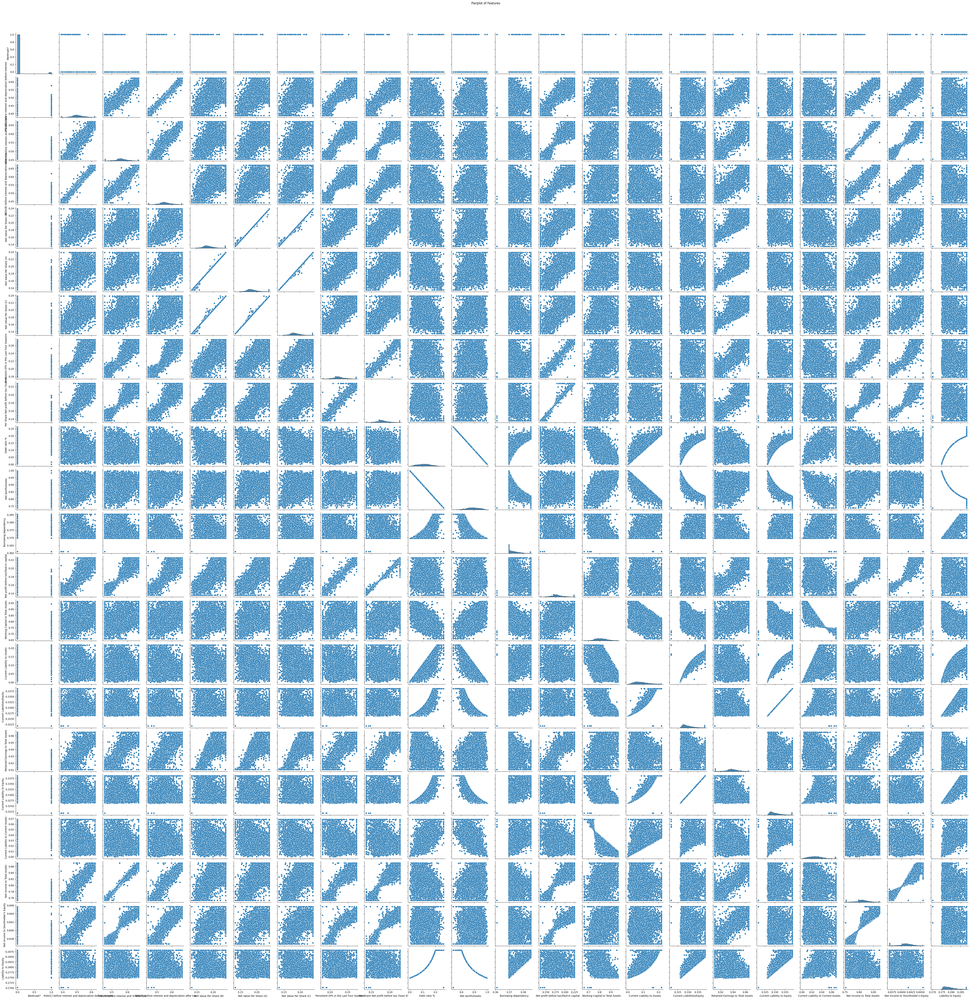

In [33]:
sns.pairplot(new_df)
show(plt.suptitle('Pairplot of Features', y=1.02))

In [34]:
# hypothesis testing
significant_features = []
for column in new_df.columns[:-1]:  # Exclude the target variable
    t_stat, p_value = stats.ttest_ind(new_df[column][new_df['Bankrupt?'] == 1], new_df[column][new_df['Bankrupt?'] == 0])
    if p_value < 0.05:
        significant_features.append(column)

# Display significant features
significant_features


C:\Users\gajja\AppData\Local\Programs\Python\Python312\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


['Bankrupt?',
 ' ROA(C) before interest and depreciation before interest',
 ' ROA(A) before interest and % after tax',
 ' ROA(B) before interest and depreciation after tax',
 ' Net Value Per Share (B)',
 ' Net Value Per Share (A)',
 ' Net Value Per Share (C)',
 ' Persistent EPS in the Last Four Seasons',
 ' Per Share Net profit before tax (Yuan ¥)',
 ' Debt ratio %',
 ' Net worth/Assets',
 ' Borrowing dependency',
 ' Net profit before tax/Paid-in capital',
 ' Working Capital to Total Assets',
 ' Current Liability to Assets',
 ' Current Liabilities/Equity',
 ' Retained Earnings to Total Assets',
 ' Current Liability to Equity',
 ' Current Liability to Current Assets',
 ' Net Income to Total Assets',
 " Net Income to Stockholder's Equity"]

In [35]:
len(significant_features)

21

In [36]:
x_train = new_df.iloc[:4500]
x_train

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Per Share Net profit before tax (Yuan ¥),Debt ratio %,Net worth/Assets,Borrowing dependency,Net profit before tax/Paid-in capital,Working Capital to Total Assets,Current Liability to Assets,Current Liabilities/Equity,Retained Earnings to Total Assets,Current Liability to Equity,Current Liability to Current Assets,Net Income to Total Assets,Net Income to Stockholder's Equity,Liability to Equity
0,1,0.387973,0.455122,0.442034,0.147950,0.147950,0.147950,0.178548,0.138736,0.207576,0.792424,0.385425,0.137757,0.672775,0.147308,0.338662,0.910524,0.338662,0.068886,0.752193,0.836752,0.288207
1,1,0.464291,0.538214,0.516730,0.182251,0.182251,0.182251,0.208944,0.169918,0.171176,0.828824,0.376760,0.168962,0.751111,0.056963,0.329740,0.931065,0.329740,0.047775,0.795297,0.839969,0.283846
2,1,0.426071,0.499019,0.472295,0.177911,0.177911,0.193713,0.180581,0.142803,0.207516,0.792484,0.379093,0.148036,0.829502,0.098162,0.334777,0.910524,0.334777,0.025346,0.774670,0.836774,0.288207
3,1,0.399844,0.455122,0.457733,0.154187,0.154187,0.154187,0.193722,0.148603,0.151465,0.848535,0.379743,0.147561,0.725754,0.098715,0.331509,0.910524,0.331509,0.067250,0.752193,0.836752,0.281721
4,1,0.465022,0.538432,0.522298,0.167502,0.167502,0.167502,0.212537,0.168412,0.106509,0.893491,0.375025,0.167461,0.751822,0.110195,0.330726,0.913850,0.330726,0.047725,0.795016,0.839973,0.278514
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4495,0,0.490128,0.543775,0.543284,0.238507,0.238507,0.238517,0.220762,0.176395,0.106267,0.893733,0.374698,0.175266,0.777697,0.047499,0.328138,0.932827,0.328138,0.029450,0.800347,0.840359,0.278501
4496,0,0.511919,0.578064,0.566465,0.184400,0.184400,0.184400,0.229933,0.184228,0.110590,0.889410,0.375077,0.183146,0.796070,0.084211,0.329731,0.939984,0.329731,0.030057,0.821412,0.841927,0.278742
4497,0,0.495052,0.556149,0.549976,0.208672,0.208672,0.208672,0.227475,0.181140,0.139190,0.860810,0.375634,0.180115,0.781786,0.109652,0.331639,0.935421,0.331639,0.036616,0.808274,0.841118,0.280665
4498,0,0.546239,0.607229,0.595214,0.215288,0.215288,0.215288,0.247896,0.203886,0.084530,0.915470,0.369637,0.202775,0.794772,0.082425,0.329229,0.944875,0.329229,0.030144,0.837331,0.842731,0.277438


In [37]:
x_test = new_df.iloc[4500:]

In [38]:
y_train = x_train["Bankrupt?"]
y_test = x_test["Bankrupt?"]

In [39]:
x_train=x_train.drop(['Bankrupt?'],axis =1)
x_test = x_test.drop(['Bankrupt?'],axis =1)

In [40]:
x_train = sm.add_constant(x_train,prepend=False)
x_test = sm.add_constant(x_test,prepend=False)

In [41]:
x_train = sm.add_constant(x_train,prepend=False)
x_test = sm.add_constant(x_test,prepend=False)
mod2 = sm.Logit(y_train,x_train).fit()

Optimization terminated successfully.
         Current function value: 0.104283
         Iterations 15


LinAlgError: Singular matrix

In [42]:
print(mod2.summary())

NameError: name 'mod2' is not defined

In [43]:
logistic_model=LogisticRegression()

In [44]:
logistic_model.fit(x_train,y_train)

LogisticRegression()

In [45]:
y_pred = logistic_model.predict(x_test)

In [46]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.98      1.00      0.99      2284
           1       0.00      0.00      0.00        35

    accuracy                           0.98      2319
   macro avg       0.49      0.50      0.50      2319
weighted avg       0.97      0.98      0.98      2319



C:\Users\gajja\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\gajja\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\gajja\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, mo

In [47]:
print(f'Accuracy: {accuracy_score(y_test, y_pred)}')

Accuracy: 0.9849072876239758


In [48]:
from sklearn.metrics import confusion_matrix

In [49]:
print(confusion_matrix(y_test,y_pred))

[[2284    0]
 [  35    0]]


In [56]:
new_df[new_df["Bankrupt?"]==1]

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Per Share Net profit before tax (Yuan ¥),Debt ratio %,Net worth/Assets,Borrowing dependency,Net profit before tax/Paid-in capital,Working Capital to Total Assets,Current Liability to Assets,Current Liabilities/Equity,Retained Earnings to Total Assets,Current Liability to Equity,Current Liability to Current Assets,Net Income to Total Assets,Net Income to Stockholder's Equity,Liability to Equity
0,1,0.387973,0.455122,0.442034,0.147950,0.147950,0.147950,0.178548,0.138736,0.207576,0.792424,0.385425,0.137757,0.672775,0.147308,0.338662,0.910524,0.338662,0.068886,0.752193,0.836752,0.288207
1,1,0.464291,0.538214,0.516730,0.182251,0.182251,0.182251,0.208944,0.169918,0.171176,0.828824,0.376760,0.168962,0.751111,0.056963,0.329740,0.931065,0.329740,0.047775,0.795297,0.839969,0.283846
2,1,0.426071,0.499019,0.472295,0.177911,0.177911,0.193713,0.180581,0.142803,0.207516,0.792484,0.379093,0.148036,0.829502,0.098162,0.334777,0.910524,0.334777,0.025346,0.774670,0.836774,0.288207
3,1,0.399844,0.455122,0.457733,0.154187,0.154187,0.154187,0.193722,0.148603,0.151465,0.848535,0.379743,0.147561,0.725754,0.098715,0.331509,0.910524,0.331509,0.067250,0.752193,0.836752,0.281721
4,1,0.465022,0.538432,0.522298,0.167502,0.167502,0.167502,0.212537,0.168412,0.106509,0.893491,0.375025,0.167461,0.751822,0.110195,0.330726,0.913850,0.330726,0.047725,0.795016,0.839973,0.278514
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6591,1,0.418515,0.455122,0.461427,0.139354,0.139354,0.139354,0.197977,0.149507,0.216555,0.783445,0.385425,0.148481,0.764816,0.211979,0.338662,0.910524,0.338662,0.044960,0.752193,0.836752,0.288207
6640,1,0.387973,0.455122,0.442034,0.134676,0.134676,0.134771,0.178548,0.135686,0.262675,0.737325,0.361014,0.136030,0.723172,0.165715,0.321756,0.910524,0.321756,0.059374,0.752193,0.845720,0.270187
6641,1,0.387973,0.455122,0.442034,0.134676,0.134676,0.134771,0.178548,0.135686,0.262675,0.737325,0.385425,0.136030,0.740426,0.218856,0.338662,0.910524,0.338662,0.050780,0.752193,0.836752,0.288207
6642,1,0.387973,0.455122,0.442034,0.134676,0.134676,0.134771,0.178548,0.135686,0.262675,0.737325,0.385425,0.136030,0.720006,0.167973,0.338662,0.910524,0.338662,0.060766,0.752193,0.836752,0.288207


In [57]:
new_df[new_df["Bankrupt?"]==0]

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Per Share Net profit before tax (Yuan ¥),Debt ratio %,Net worth/Assets,Borrowing dependency,Net profit before tax/Paid-in capital,Working Capital to Total Assets,Current Liability to Assets,Current Liabilities/Equity,Retained Earnings to Total Assets,Current Liability to Equity,Current Liability to Current Assets,Net Income to Total Assets,Net Income to Stockholder's Equity,Liability to Equity
6,0,0.390923,0.455122,0.442034,0.158822,0.158822,0.158822,0.178548,0.135686,0.216102,0.783898,0.384999,0.136030,0.729416,0.115920,0.337392,0.911441,0.337392,0.060765,0.752193,0.836752,0.288207
7,0,0.508361,0.570922,0.559077,0.176984,0.176984,0.176984,0.225206,0.180462,0.108202,0.891798,0.374219,0.179519,0.797005,0.087042,0.329804,0.935449,0.329804,0.030201,0.815350,0.841459,0.278607
8,0,0.488519,0.545137,0.543284,0.184189,0.184189,0.184189,0.218398,0.173157,0.058591,0.941409,0.370253,0.172159,0.813738,0.058060,0.328093,0.935200,0.328093,0.021710,0.803647,0.840487,0.276423
9,0,0.495686,0.550916,0.542963,0.177447,0.177447,0.177447,0.217831,0.176621,0.121293,0.878707,0.374509,0.175658,0.825696,0.094563,0.330409,0.938290,0.330409,0.025494,0.804195,0.840688,0.279388
10,0,0.482475,0.567543,0.538198,0.182925,0.182925,0.182925,0.218966,0.178579,0.103577,0.896423,0.374180,0.177611,0.751204,0.032087,0.327485,0.942829,0.327485,0.047166,0.814111,0.841337,0.278356
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6814,0,0.493687,0.539468,0.543230,0.175045,0.175045,0.175045,0.216602,0.172102,0.124618,0.875382,0.373823,0.171111,0.817769,0.103838,0.330914,0.925611,0.330914,0.027951,0.799927,0.840359,0.279606
6815,0,0.475162,0.538269,0.524172,0.181324,0.181324,0.181324,0.216697,0.172780,0.099253,0.900747,0.372505,0.171805,0.793387,0.089901,0.329753,0.932629,0.329753,0.031470,0.799748,0.840306,0.278132
6816,0,0.472725,0.533744,0.520638,0.238507,0.238507,0.238517,0.210929,0.173232,0.038939,0.961061,0.369637,0.172287,0.866047,0.024414,0.326921,0.932000,0.326921,0.007542,0.797778,0.840138,0.275789
6817,0,0.506264,0.559911,0.554045,0.213392,0.213392,0.213392,0.228326,0.185584,0.086979,0.913021,0.369649,0.182498,0.832340,0.083199,0.329294,0.939613,0.329294,0.022916,0.811808,0.841084,0.277547


In [52]:
#we will reject all this

In [58]:
new_df_zero=new_df[new_df["Bankrupt?"]==0].sample(220)

In [59]:
len(new_df_zero)

220

In [55]:
new_df[new_df["Bankrupt?"]!=0]

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Per Share Net profit before tax (Yuan ¥),Debt ratio %,Net worth/Assets,Borrowing dependency,Net profit before tax/Paid-in capital,Working Capital to Total Assets,Current Liability to Assets,Current Liabilities/Equity,Retained Earnings to Total Assets,Current Liability to Equity,Current Liability to Current Assets,Net Income to Total Assets,Net Income to Stockholder's Equity,Liability to Equity
0,1,0.387973,0.455122,0.442034,0.147950,0.147950,0.147950,0.178548,0.138736,0.207576,0.792424,0.385425,0.137757,0.672775,0.147308,0.338662,0.910524,0.338662,0.068886,0.752193,0.836752,0.288207
1,1,0.464291,0.538214,0.516730,0.182251,0.182251,0.182251,0.208944,0.169918,0.171176,0.828824,0.376760,0.168962,0.751111,0.056963,0.329740,0.931065,0.329740,0.047775,0.795297,0.839969,0.283846
2,1,0.426071,0.499019,0.472295,0.177911,0.177911,0.193713,0.180581,0.142803,0.207516,0.792484,0.379093,0.148036,0.829502,0.098162,0.334777,0.910524,0.334777,0.025346,0.774670,0.836774,0.288207
3,1,0.399844,0.455122,0.457733,0.154187,0.154187,0.154187,0.193722,0.148603,0.151465,0.848535,0.379743,0.147561,0.725754,0.098715,0.331509,0.910524,0.331509,0.067250,0.752193,0.836752,0.281721
4,1,0.465022,0.538432,0.522298,0.167502,0.167502,0.167502,0.212537,0.168412,0.106509,0.893491,0.375025,0.167461,0.751822,0.110195,0.330726,0.913850,0.330726,0.047725,0.795016,0.839973,0.278514
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6591,1,0.418515,0.455122,0.461427,0.139354,0.139354,0.139354,0.197977,0.149507,0.216555,0.783445,0.385425,0.148481,0.764816,0.211979,0.338662,0.910524,0.338662,0.044960,0.752193,0.836752,0.288207
6640,1,0.387973,0.455122,0.442034,0.134676,0.134676,0.134771,0.178548,0.135686,0.262675,0.737325,0.361014,0.136030,0.723172,0.165715,0.321756,0.910524,0.321756,0.059374,0.752193,0.845720,0.270187
6641,1,0.387973,0.455122,0.442034,0.134676,0.134676,0.134771,0.178548,0.135686,0.262675,0.737325,0.385425,0.136030,0.740426,0.218856,0.338662,0.910524,0.338662,0.050780,0.752193,0.836752,0.288207
6642,1,0.387973,0.455122,0.442034,0.134676,0.134676,0.134771,0.178548,0.135686,0.262675,0.737325,0.385425,0.136030,0.720006,0.167973,0.338662,0.910524,0.338662,0.060766,0.752193,0.836752,0.288207


In [60]:
new_df_one = new_df[new_df["Bankrupt?"]!=0].sample(220)

In [61]:
len(new_df_one)

220

In [62]:
new_bank = pd.concat([new_df_zero,new_df_one], axis=0)

In [63]:
len(new_bank)

440

In [64]:
X_train, X_test, y_train, y_test = train_test_split(new_bank.drop(['Bankrupt?'], axis=1), new_bank['Bankrupt?'], test_size=0.2)

In [65]:
X_train = sm.add_constant(X_train,prepend=False)
X_test = sm.add_constant(X_test,prepend=False)

In [66]:
mod2 = sm.Logit(y_train,X_train).fit()

         Current function value: 0.285852
         Iterations: 35


C:\Users\gajja\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [67]:
print(mod2.summary())

                           Logit Regression Results                           
Dep. Variable:              Bankrupt?   No. Observations:                  352
Model:                          Logit   Df Residuals:                      332
Method:                           MLE   Df Model:                           19
Date:                Wed, 19 Jun 2024   Pseudo R-squ.:                  0.5876
Time:                        10:03:19   Log-Likelihood:                -100.62
converged:                      False   LL-Null:                       -243.98
Covariance Type:            nonrobust   LLR p-value:                 1.042e-49
                                                               coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------------------------------
 ROA(C) before interest and depreciation before interest   -56.3946     32.573     -1.731      0.083    -120.236      

In [68]:
logistic_model=LogisticRegression()

In [69]:
logistic_model.fit(X_train,y_train)

LogisticRegression()

In [70]:
y_pred = logistic_model.predict(X_test)

In [71]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.90      0.82      0.86        45
           1       0.83      0.91      0.87        43

    accuracy                           0.86        88
   macro avg       0.87      0.86      0.86        88
weighted avg       0.87      0.86      0.86        88



In [72]:
print(f'Accuracy: {accuracy_score(y_test, y_pred)}')

Accuracy: 0.8636363636363636


In [73]:
from sklearn.metrics import confusion_matrix

In [74]:
print(confusion_matrix(y_test,y_test))

[[45  0]
 [ 0 43]]
